# Rain prediction in Australia


<img src="../images/1786.webp" height=500 width=700>

In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import seaborn as sns 
import matplotlib.pyplot as plt
# machine learning
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC, LinearSVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import SGDClassifier
from sklearn.tree import DecisionTreeClassifier
from xgboost import XGBClassifier


import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))



In [2]:
import numpy as np
import pandas as pd
import seaborn as sns 

import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler


In [3]:
from sklearn.metrics import precision_score, recall_score, f1_score, classification_report
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score, accuracy_score, confusion_matrix
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV

In [4]:
def print_results(clf, X_val, y_val):
    y_pred = clf.predict(X_val)
    print(confusion_matrix(y_val,y_pred), ": is the confustion matrix")
    print(accuracy_score(y_val,y_pred), ": is the accuracy score")
    print(precision_score(y_val,y_pred), ": is the precision score")
    print(recall_score(y_val,y_pred), ": is the recall score")
    print(f1_score(y_val,y_pred), ": is the f1 score")


# 1. Load data

In [5]:
df = pd.read_csv('../data/weatherAUS.csv')
df.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No


In [6]:
df.describe()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
count,143975.000000,144199.000000,142199.000000,82670.000000,75625.000000,135197.000000,143693.000000,142398.000000,142806.000000,140953.000000,130395.00000,130432.000000,89572.000000,86102.000000,143693.000000,141851.00000
mean,12.194034,23.221348,2.360918,5.468232,7.611178,40.035230,14.043426,18.662657,68.880831,51.539116,1017.64994,1015.255889,4.447461,4.509930,16.990631,21.68339
std,6.398495,7.119049,8.478060,4.193704,3.785483,13.607062,8.915375,8.809800,19.029164,20.795902,7.10653,7.037414,2.887159,2.720357,6.488753,6.93665
min,-8.500000,-4.800000,0.000000,0.000000,0.000000,6.000000,0.000000,0.000000,0.000000,0.000000,980.50000,977.100000,0.000000,0.000000,-7.200000,-5.40000
25%,7.600000,17.900000,0.000000,2.600000,4.800000,31.000000,7.000000,13.000000,57.000000,37.000000,1012.90000,1010.400000,1.000000,2.000000,12.300000,16.60000
50%,12.000000,22.600000,0.000000,4.800000,8.400000,39.000000,13.000000,19.000000,70.000000,52.000000,1017.60000,1015.200000,5.000000,5.000000,16.700000,21.10000
75%,16.900000,28.200000,0.800000,7.400000,10.600000,48.000000,19.000000,24.000000,83.000000,66.000000,1022.40000,1020.000000,7.000000,7.000000,21.600000,26.40000
max,33.900000,48.100000,371.000000,145.000000,14.500000,135.000000,130.000000,87.000000,100.000000,100.000000,1041.00000,1039.600000,9.000000,9.000000,40.200000,46.70000


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145460 entries, 0 to 145459
Data columns (total 23 columns):
Date             145460 non-null object
Location         145460 non-null object
MinTemp          143975 non-null float64
MaxTemp          144199 non-null float64
Rainfall         142199 non-null float64
Evaporation      82670 non-null float64
Sunshine         75625 non-null float64
WindGustDir      135134 non-null object
WindGustSpeed    135197 non-null float64
WindDir9am       134894 non-null object
WindDir3pm       141232 non-null object
WindSpeed9am     143693 non-null float64
WindSpeed3pm     142398 non-null float64
Humidity9am      142806 non-null float64
Humidity3pm      140953 non-null float64
Pressure9am      130395 non-null float64
Pressure3pm      130432 non-null float64
Cloud9am         89572 non-null float64
Cloud3pm         86102 non-null float64
Temp9am          143693 non-null float64
Temp3pm          141851 non-null float64
RainToday        142199 non-null obje

In [8]:
corr_matrix = df.corr()# Check Correlations
print(corr_matrix)

                MinTemp   MaxTemp  Rainfall  Evaporation  Sunshine  \
MinTemp        1.000000  0.736555  0.103938     0.466993  0.072586   
MaxTemp        0.736555  1.000000 -0.074992     0.587932  0.470156   
Rainfall       0.103938 -0.074992  1.000000    -0.064351 -0.227549   
Evaporation    0.466993  0.587932 -0.064351     1.000000  0.365602   
Sunshine       0.072586  0.470156 -0.227549     0.365602  1.000000   
WindGustSpeed  0.177415  0.067615  0.133659     0.203021 -0.034750   
WindSpeed9am   0.175064  0.014450  0.087338     0.193084  0.005499   
WindSpeed3pm   0.175173  0.050300  0.057887     0.129400  0.053834   
Humidity9am   -0.232899 -0.504110  0.224405    -0.504092 -0.490819   
Humidity3pm    0.006089 -0.508855  0.255755    -0.390243 -0.629130   
Pressure9am   -0.450970 -0.332061 -0.168154    -0.270362  0.041970   
Pressure3pm   -0.461292 -0.427167 -0.126534    -0.293581 -0.019719   
Cloud9am       0.078754 -0.289370  0.198528    -0.183793 -0.675323   
Cloud3pm       0.021

***
# Prepare Data 
***

In [9]:
weather_today = df.copy()
#rain_tomorrow  = df.RainTomorrow.copy()

In [10]:
weather_today['Month'] = weather_today.Date.apply(lambda x : int(x.split('-')[1]))
weather_today.drop('Date',axis=1, inplace=True)
weather_today.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Month
0,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,...,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No,12
1,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,...,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No,12
2,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,WSW,...,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No,12
3,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,E,...,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No,12
4,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,NW,...,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No,12


In [11]:
"""
weather_today.RainTomorrow.value_counts() 
weather_No = weather_today[weather_today.RainTomorrow=='No'].sample(frac=1,random_state=0)
weather_Yes = weather_today[weather_today.RainTomorrow=='Yes']
print("Yes shape =",weather_Yes.shape)
weather_Yes.head()
weather_No = weather_No.iloc[:weather_Yes.shape[0],:]
weather_No.shape
weather_balanced = pd.concat([weather_No, weather_Yes])
weather_balanced.shape
weather_today = weather_balanced
weather_today = weather_today.sample(frac=1,random_state=0)
weather_today.head()
"""

'\nweather_today.RainTomorrow.value_counts() \nweather_No = weather_today[weather_today.RainTomorrow==\'No\'].sample(frac=1,random_state=0)\nweather_Yes = weather_today[weather_today.RainTomorrow==\'Yes\']\nprint("Yes shape =",weather_Yes.shape)\nweather_Yes.head()\nweather_No = weather_No.iloc[:weather_Yes.shape[0],:]\nweather_No.shape\nweather_balanced = pd.concat([weather_No, weather_Yes])\nweather_balanced.shape\nweather_today = weather_balanced\nweather_today = weather_today.sample(frac=1,random_state=0)\nweather_today.head()\n'

In [12]:
rain_tomorrow  = weather_today.RainTomorrow.copy()
weather_today = weather_today.drop("RainTomorrow",axis=1).copy()
weather_today.head()


,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,Month
0,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,12
1,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,12
2,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,WSW,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,12
3,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,E,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,12
4,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,NW,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,12


In [13]:
zeros_cnt = weather_today.isnull().sum().sort_values(ascending=False)
percent_zeros = ( weather_today.isnull().sum() /  weather_today.isnull().count()).sort_values(ascending=False)

missing_data = pd.concat([zeros_cnt, percent_zeros], axis=1, keys=['Total', 'Percent'])
missing_data

,Total,Percent
Sunshine,69835,0.480098
Evaporation,62790,0.431665
Cloud3pm,59358,0.408071
Cloud9am,55888,0.384216
Pressure9am,15065,0.103568
Pressure3pm,15028,0.103314
WindDir9am,10566,0.072639
WindGustDir,10326,0.070989
WindGustSpeed,10263,0.070555
Humidity3pm,4507,0.030984


In [14]:
for column in [cl for cl in weather_today.columns if weather_today[cl].dtype in ['float64']]:
#for column in ['Evaporation']:
    print(f"Working on Column: {column}")
    for location in weather_today.Location.unique():
        for month in weather_today.Month.unique():
            mean_for_month = weather_today[(weather_today.Location == location) & (weather_today.Month == month)][column].mean()
            if np.isnan(mean_for_month):
                idx = weather_today[(weather_today.Location == location) & (weather_today.Month == month)][column].index
                weather_today.drop(idx,axis=0,inplace=True)

                #mean_for_month = weather_today[(weather_today.Month == month)][column].median()
            idx = list(weather_today[(weather_today.Location == location) & (weather_today.Month == month) & (weather_today[column].isna())].index)
            weather_today.loc[idx,column] = mean_for_month
weather_today.head(100)

Working on Column: MinTemp
Working on Column: MaxTemp
Working on Column: Rainfall
Working on Column: Evaporation
Working on Column: Sunshine
Working on Column: WindGustSpeed
Working on Column: WindSpeed9am
Working on Column: WindSpeed3pm
Working on Column: Humidity9am
Working on Column: Humidity3pm
Working on Column: Pressure9am
Working on Column: Pressure3pm
Working on Column: Cloud9am
Working on Column: Cloud3pm
Working on Column: Temp9am
Working on Column: Temp3pm


,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,Month
6049,Cobar,17.9,35.2,0.0,12.0,12.3,SSW,48.0,ENE,SW,...,20.000000,13.0,1006.300000,1004.4,2.000000,5.0,26.600000,33.4,No,1
6050,Cobar,18.4,28.9,0.0,14.8,13.0,S,37.0,SSE,SSE,...,30.000000,8.0,1012.900000,1012.1,1.000000,1.0,20.300000,27.0,No,1
6051,Cobar,15.5,34.1,0.0,12.6,13.3,SE,30.0,NaN,N,...,41.902622,7.0,1011.146014,1011.6,2.778723,1.0,26.467391,32.7,No,1
6052,Cobar,19.4,37.6,0.0,10.8,10.6,NNE,46.0,NNE,NNW,...,42.000000,22.0,1012.300000,1009.2,1.000000,6.0,28.700000,34.9,No,1
6053,Cobar,21.9,38.4,0.0,11.4,12.2,WNW,31.0,WNW,WSW,...,37.000000,22.0,1012.700000,1009.1,1.000000,5.0,29.100000,35.6,No,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6144,Cobar,10.7,23.3,0.0,6.2,11.0,SSW,43.0,SSE,S,...,53.000000,23.0,1021.200000,1018.6,0.000000,0.0,16.400000,22.2,No,4
6145,Cobar,9.4,25.6,0.0,7.6,11.2,SSW,31.0,S,SSE,...,44.000000,26.0,1023.600000,1020.0,0.000000,0.0,13.800000,24.6,No,4
6146,Cobar,13.5,28.4,0.0,5.8,9.0,ENE,35.0,ENE,ENE,...,57.000000,32.0,1023.000000,1019.8,1.000000,3.0,19.900000,28.1,No,4
6147,Cobar,17.1,28.7,0.0,6.6,5.5,WNW,43.0,ENE,ENE,...,45.000000,32.0,1021.200000,1016.9,7.000000,7.0,20.100000,26.7,No,4


In [15]:
zeros_cnt = weather_today.isnull().sum().sort_values(ascending=False)
percent_zeros = ( weather_today.isnull().sum() /  weather_today.isnull().count()).sort_values(ascending=False)

missing_data = pd.concat([zeros_cnt, percent_zeros], axis=1, keys=['Total', 'Percent'])
missing_data

,Total,Percent
WindDir9am,2815,0.035170
WindGustDir,2758,0.034458
RainToday,1724,0.021539
WindDir3pm,910,0.011369
Month,0,0.000000
MinTemp,0,0.000000
MaxTemp,0,0.000000
Rainfall,0,0.000000
Evaporation,0,0.000000
Sunshine,0,0.000000


**Check how balanced the data is for the target column**

**Now we will deal with the null values**

# 2. Data preprocessing

**Let's drop those features where the missing/total coefficient is higher than 15%.**

**A pairplot helps visualize dependencies and correlation between features. Some of them have quite obvious links.**

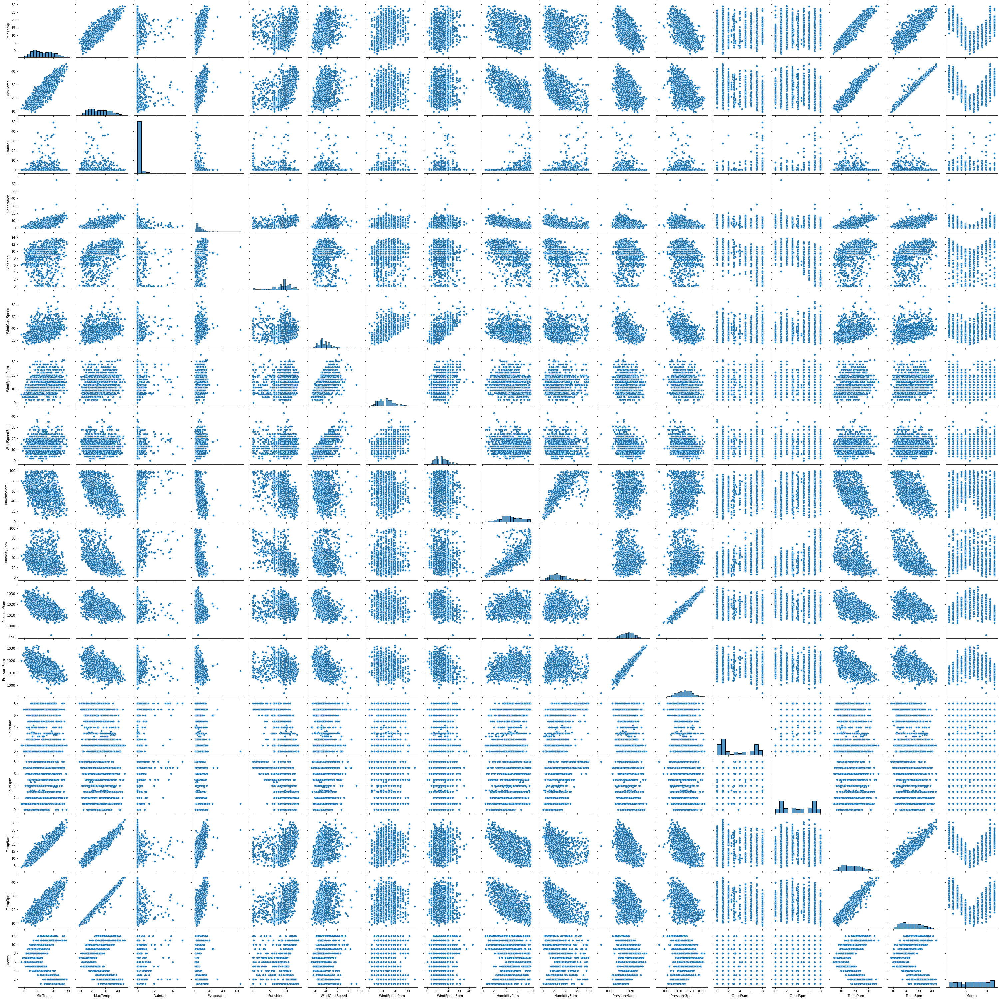

In [16]:
sns.pairplot(weather_today[:1000])

**Comments on the pairplots: There are few linear relations with high values of the r pearson coefficient.**

***
**Take the month out of the Date and move it to its own cell**

In [17]:
num_columns = [column for column in weather_today.columns if weather_today[column].dtype == 'float64']
print(num_columns)

['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm']


In [18]:

num_pipline = Pipeline([
    ('std_scaler', StandardScaler()),
])

In [19]:
weather_today[num_columns] = num_pipline.fit_transform(weather_today[num_columns])
weather_today.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,Month
6049,Cobar,0.756472,1.618916,-0.264776,1.561567,1.326621,SSW,0.548603,ENE,SW,...,-2.484893,-1.790413,-1.595873,-1.532709,-0.865738,0.227582,1.348715,1.608812,No,1
6050,Cobar,0.833565,0.714245,-0.264776,2.239770,1.527115,S,-0.279217,SSE,SSE,...,-1.950034,-2.035484,-0.652765,-0.421746,-1.234440,-1.348886,0.387497,0.669970,No,1
6051,Cobar,0.386427,1.460958,-0.264776,1.706896,1.613041,SE,-0.806011,NaN,N,...,-1.313411,-2.084499,-0.903401,-0.493886,-0.578621,-1.348886,1.328482,1.506126,No,1
6052,Cobar,0.987750,1.963553,-0.264776,1.270909,0.839707,NNE,0.398090,NNE,NNW,...,-1.308203,-1.349285,-0.738502,-0.840161,-1.234440,0.621700,1.669121,1.828853,No,1
6053,Cobar,1.373214,2.078432,-0.264776,1.416238,1.297979,WNW,-0.730755,WNW,WSW,...,-1.575632,-1.349285,-0.681344,-0.854589,-1.234440,0.227582,1.730151,1.931539,No,1


**Let's encode categorical features using one-hot-encoding.**

In [20]:
ohe = pd.get_dummies(data=weather_today, columns=['WindGustDir','WindDir9am','WindDir3pm','Location'],drop_first=True)
ohe.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 80040 entries, 6049 to 142303
Data columns (total 88 columns):
MinTemp                      80040 non-null float64
MaxTemp                      80040 non-null float64
Rainfall                     80040 non-null float64
Evaporation                  80040 non-null float64
Sunshine                     80040 non-null float64
WindGustSpeed                80040 non-null float64
WindSpeed9am                 80040 non-null float64
WindSpeed3pm                 80040 non-null float64
Humidity9am                  80040 non-null float64
Humidity3pm                  80040 non-null float64
Pressure9am                  80040 non-null float64
Pressure3pm                  80040 non-null float64
Cloud9am                     80040 non-null float64
Cloud3pm                     80040 non-null float64
Temp9am                      80040 non-null float64
Temp3pm                      80040 non-null float64
RainToday                    78316 non-null object
Mont

In [21]:
from sklearn import preprocessing
from numpy import array

ohe['RainToday'] = weather_today['RainToday'].astype(str)
ohe['RainTomorrow'] =rain_tomorrow.astype(str)

lb = preprocessing.LabelBinarizer()

ohe['RainToday'] = lb.fit_transform(ohe['RainToday'])
ohe['RainTomorrow'] = lb.fit_transform(ohe['RainTomorrow'])

**Drop missing values and create target column y and data X**

In [22]:
ohe = ohe.dropna()
#ohe.drop('Location', axis=1, inplace=True)
y = ohe['RainTomorrow']
X = ohe.drop(['RainTomorrow'], axis=1)

In [23]:
X.head()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,Location_PerthAirport,Location_Portland,Location_Sale,Location_Sydney,Location_SydneyAirport,Location_Townsville,Location_WaggaWagga,Location_Watsonia,Location_Williamtown,Location_Woomera
6049,0.756472,1.618916,-0.264776,1.561567,1.326621,0.548603,-1.090135,0.043455,-2.484893,-1.790413,...,0,0,0,0,0,0,0,0,0,0
6050,0.833565,0.714245,-0.264776,2.239770,1.527115,-0.279217,0.427469,-0.073453,-1.950034,-2.035484,...,0,0,0,0,0,0,0,0,0,0
6051,0.386427,1.460958,-0.264776,1.706896,1.613041,-0.806011,0.223599,-1.476351,-1.313411,-2.084499,...,0,0,0,0,0,0,0,0,0,0
6052,0.987750,1.963553,-0.264776,1.270909,0.839707,0.398090,1.711595,-0.541085,-1.308203,-1.349285,...,0,0,0,0,0,0,0,0,0,0
6053,1.373214,2.078432,-0.264776,1.416238,1.297979,-0.730755,-1.090135,-1.593259,-1.575632,-1.349285,...,0,0,0,0,0,0,0,0,0,0


In [24]:
y.head()

6049    1
6050    1
6051    1
6052    1
6053    1
Name: RainTomorrow, dtype: int64

# 3. Model building

In [25]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=0) # split the data into train/test datasets
X_train,X_val,y_train,y_val = train_test_split(X_train, y_train, test_size=0.3,random_state=0) 
allValues = (X_train,X_val,y_train,y_val)

In [26]:
X_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 39219 entries, 61937 to 102107
Data columns (total 88 columns):
MinTemp                      39219 non-null float64
MaxTemp                      39219 non-null float64
Rainfall                     39219 non-null float64
Evaporation                  39219 non-null float64
Sunshine                     39219 non-null float64
WindGustSpeed                39219 non-null float64
WindSpeed9am                 39219 non-null float64
WindSpeed3pm                 39219 non-null float64
Humidity9am                  39219 non-null float64
Humidity3pm                  39219 non-null float64
Pressure9am                  39219 non-null float64
Pressure3pm                  39219 non-null float64
Cloud9am                     39219 non-null float64
Cloud3pm                     39219 non-null float64
Temp9am                      39219 non-null float64
Temp3pm                      39219 non-null float64
RainToday                    39219 non-null int64
Mont

In [27]:
def assessClassifier(clf,allValues):
    name = str(clf)
    X_train,X_test,y_train,y_test = allValues
    pipe = Pipeline([('scaler', StandardScaler()), (name, clf)])
    pipe.fit(X_train,y_train)
    y_pred = pipe.predict(X_test)
    f1 = f1_score(y_test, y_pred)
    precision = precision_score(y_test,y_pred)
    recall = recall_score(y_test,y_pred)
    roc_auc_sc = roc_auc_score(y_test,y_pred)
    accuracy = accuracy_score(y_test,y_pred)
    return {'name':name,'f1':f1, 'precision':precision,'recall':recall,'roc_auc_score':roc_auc_sc,'accuracy':accuracy}

In [28]:
clf_Logistic = LogisticRegression()
clf_Forest = RandomForestClassifier()
clf_KNN = KNeighborsClassifier()
clf_SVC = SVC()
clf_XGBoost = XGBClassifier()
clf_NaiveB = GaussianNB()

In [29]:
details = {'name':[],'f1':[],'precision':[],'recall':[],'roc_auc_score':[], 'accuracy':[]}
for clf in [clf_Logistic, clf_Forest, clf_KNN,clf_SVC, clf_XGBoost, clf_NaiveB]:#clf_Logistic, clf_Forest,
    print(f"Working on {str(clf)}")
    results = assessClassifier(clf, allValues)
    for item in results.keys():
        details[item].append(results[item])

Working on LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=None, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)
Working on RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)
Working on KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     

In [30]:
df = pd.DataFrame(details)
df

,name,f1,precision,recall,roc_auc_score,accuracy
0,"LogisticRegression(C=1.0, class_weight=None, d...",0.899753,0.865376,0.936974,0.733023,0.840562
1,"RandomForestClassifier(bootstrap=True, ccp_alp...",0.906424,0.867855,0.948582,0.740966,0.850437
2,"KNeighborsClassifier(algorithm='auto', leaf_si...",0.875687,0.822286,0.936507,0.641296,0.796954
3,"SVC(C=1.0, break_ties=False, cache_size=200, c...",0.907181,0.869112,0.948738,0.743561,0.851746
4,"XGBClassifier(base_score=None, booster=None, c...",0.907032,0.877101,0.939078,0.756979,0.852995
5,"GaussianNB(priors=None, var_smoothing=1e-09)",0.799332,0.887505,0.727096,0.714668,0.721221


***
#  Comments on Vanilla Classifiers 
### I will use RandomForestClassifier, SVC, and XGBClassifier Classifiers for tune ups and comparison
***

***
# Tune up Logistic Regression
***

In [31]:
c_space = np.logspace(-5, 8, 15)
param_grid = {'C': c_space}
grid_search_LogReg = GridSearchCV(LogisticRegression(), param_grid, cv=10, scoring='precision',
                                return_train_score=True, verbose=1, n_jobs=-1)

In [32]:
grid_search_LogReg.fit(X_train,y_train)

Fitting 10 folds for each of 15 candidates, totalling 150 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 20 concurrent workers.
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 150 out of 150 | elapsed:   13.0s finished
/usr/lib/python3/dist-packages/sklearn/linear_model/_logistic.py:938: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


GridSearchCV(cv=10, error_score=nan,
             estimator=LogisticRegression(C=1.0, class_weight=None, dual=False,
                                          fit_intercept=True,
                                          intercept_scaling=1, l1_ratio=None,
                                          max_iter=100, multi_class='auto',
                                          n_jobs=None, penalty='l2',
                                          random_state=None, solver='lbfgs',
                                          tol=0.0001, verbose=0,
                                          warm_start=False),
             iid='deprecated', n_jobs=-1,
             param_grid={'C': array([1.00000000e-05, 8.48342898e-05, 7.19685673e-04, 6.10540230e-03,
       5.17947468e-02, 4.39397056e-01, 3.72759372e+00, 3.16227766e+01,
       2.68269580e+02, 2.27584593e+03, 1.93069773e+04, 1.63789371e+05,
       1.38949549e+06, 1.17876863e+07, 1.00000000e+08])},
             pre_dispatch='2*n_jobs', refit=True, re

In [33]:
print_results(grid_search_LogReg,X_train,y_train)

[[ 4895  4251]
 [ 1869 28204]] : is the confustion matrix
0.8439531859557867 : is the accuracy score
0.8690186411955014 : is the precision score
0.9378512286768862 : is the recall score
0.9021238485158648 : is the f1 score


In [34]:
print_results(grid_search_LogReg,X_val,y_val)

[[ 2099  1874]
 [  808 12028]] : is the confustion matrix
0.8404426200249866 : is the accuracy score
0.8651992519062005 : is the precision score
0.9370520411343097 : is the recall score
0.8996933203680155 : is the f1 score


In [35]:
print_results(grid_search_LogReg,X_test,y_test)

[[ 3090  2645]
 [ 1132 17145]] : is the confustion matrix
0.842703648175912 : is the accuracy score
0.8663466397170289 : is the precision score
0.93806423373639 : is the recall score
0.9007802033257153 : is the f1 score


***
# Tune up Random Forest
***

In [36]:
param_grid = [
    {'n_estimators':[3,10,30,50,], 'max_features':[2,4,6,8]},
   # {'n_estimators': [50, 60, 70,80,90,100,110],
    #'max_features': ['auto'],
    #'max_depth' : [5,10,20, 30, 40, 50 ,60 , 70],
    #'criterion' :['gini', 'entropy']},
    #{'bootstrap':[True],'n_estimators':[3,5,10,20],'max_features':['auto']},
]

In [37]:
grid_search_RandomForest = GridSearchCV(RandomForestClassifier(), param_grid, cv=10, scoring='precision',
                            return_train_score=True, verbose=1, n_jobs = -1)

In [38]:
grid_search_RandomForest.fit(X_train,y_train)

Fitting 10 folds for each of 16 candidates, totalling 160 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 20 concurrent workers.
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 160 out of 160 | elapsed:   17.0s finished


GridSearchCV(cv=10, error_score=nan,
             estimator=RandomForestClassifier(bootstrap=True, ccp_alpha=0.0,
                                              class_weight=None,
                                              criterion='gini', max_depth=None,
                                              max_features='auto',
                                              max_leaf_nodes=None,
                                              max_samples=None,
                                              min_impurity_decrease=0.0,
                                              min_impurity_split=None,
                                              min_samples_leaf=1,
                                              min_samples_split=2,
                                              min_weight_fraction_leaf=0.0,
                                              n_estimators=100, n_jobs=None,
                                              oob_score=False,
                                              rand

In [39]:
print(grid_search_RandomForest.best_params_)

{'max_features': 6, 'n_estimators': 10}


In [40]:
print_results(grid_search_RandomForest,X_train,y_train)

[[ 8998   148]
 [  119 29954]] : is the confustion matrix
0.9931920752696397 : is the accuracy score
0.9950833831639094 : is the precision score
0.9960429621254946 : is the recall score
0.9955629414208558 : is the f1 score


In [41]:
print_results(grid_search_RandomForest, X_val,y_val)

[[ 2226  1747]
 [ 1132 11704]] : is the confustion matrix
0.8287227080730561 : is the accuracy score
0.8701211805813694 : is the precision score
0.9118105328762854 : is the recall score
0.8904781831323468 : is the f1 score


In [42]:
print_results(grid_search_RandomForest,X_test,y_test)

[[ 3334  2401]
 [ 1597 16680]] : is the confustion matrix
0.8334999167083125 : is the accuracy score
0.8741680205439967 : is the precision score
0.9126224216228046 : is the recall score
0.8929814229883827 : is the f1 score


***
# Tune up SVC
***

In [43]:
Cs = [0.001, 0.01, 0.1 ,1, 10, 100, 1000, 10000]
#Cs = [0.001, 0.1 ,1, 100, 10000]
gammas = [0.00000001 ,0.0000001, 0.000001, 0.00001, 0.0001, 0.001, 0.01, 0.1 , 1, 10, 100, 200, 300, 1000]
#gammas = [ 1,2,7,8,9,10,11,12,13]
param_grid = {'C':Cs, 'gamma':gammas }

In [44]:
grid_search_SVC = GridSearchCV(SVC(kernel='poly'), param_grid=param_grid, cv=10, scoring='precision',verbose=1,n_jobs=-1)

In [45]:
grid_search_SVC.fit(X_train[:6000],y_train[:6000])

Fitting 10 folds for each of 112 candidates, totalling 1120 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 20 concurrent workers.
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    4.2s
[Parallel(n_jobs=-1)]: Done 160 tasks      | elapsed:   49.8s
[Parallel(n_jobs=-1)]: Done 410 tasks      | elapsed:  2.2min
[Parallel(n_jobs=-1)]: Done 760 tasks      | elapsed:  3.9min
[Parallel(n_jobs=-1)]: Done 1120 out of 1120 | elapsed:  6.2min finished


GridSearchCV(cv=10, error_score=nan,
             estimator=SVC(C=1.0, break_ties=False, cache_size=200,
                           class_weight=None, coef0=0.0,
                           decision_function_shape='ovr', degree=3,
                           gamma='scale', kernel='poly', max_iter=-1,
                           probability=False, random_state=None, shrinking=True,
                           tol=0.001, verbose=False),
             iid='deprecated', n_jobs=-1,
             param_grid={'C': [0.001, 0.01, 0.1, 1, 10, 100, 1000, 10000],
                         'gamma': [1e-08, 1e-07, 1e-06, 1e-05, 0.0001, 0.001,
                                   0.01, 0.1, 1, 10, 100, 200, 300, 1000]},
             pre_dispatch='2*n_jobs', refit=True, return_train_score=False,
             scoring='precision', verbose=1)

In [46]:
print(grid_search_SVC.best_estimator_)

SVC(C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma=1, kernel='poly',
    max_iter=-1, probability=False, random_state=None, shrinking=True,
    tol=0.001, verbose=False)


In [47]:
print_results(grid_search_SVC,X_train,y_train)

[[ 5702  3444]
 [ 3238 26835]] : is the confustion matrix
0.8296233968229685 : is the accuracy score
0.8862578024373328 : is the precision score
0.8923286669105177 : is the recall score
0.8892828738069989 : is the f1 score


In [48]:
print_results(grid_search_SVC, X_val,y_val)

[[ 2211  1762]
 [ 1645 11191]] : is the confustion matrix
0.7973109643643286 : is the accuracy score
0.8639697367405235 : is the precision score
0.871844811467747 : is the recall score
0.8678894102136571 : is the f1 score


In [49]:
print_results(grid_search_LogReg,X_test,y_test)

[[ 3090  2645]
 [ 1132 17145]] : is the confustion matrix
0.842703648175912 : is the accuracy score
0.8663466397170289 : is the precision score
0.93806423373639 : is the recall score
0.9007802033257153 : is the f1 score


***
# Tune up NaiveBaeys
***

In [50]:
param_grid_nb = {
    'var_smoothing':np.logspace(0, -15, num=100)

}

In [51]:
nbModel_grid = GridSearchCV(estimator=GaussianNB(),param_grid = param_grid_nb, verbose =1, cv=10, n_jobs=-1,scoring='precision')

In [52]:
nbModel_grid.fit(X_train,y_train)

Fitting 10 folds for each of 100 candidates, totalling 1000 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 20 concurrent workers.
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 160 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 410 tasks      | elapsed:    5.5s
[Parallel(n_jobs=-1)]: Done 760 tasks      | elapsed:    9.2s
[Parallel(n_jobs=-1)]: Done 1000 out of 1000 | elapsed:   11.6s finished


GridSearchCV(cv=10, error_score=nan,
             estimator=GaussianNB(priors=None, var_smoothing=1e-09),
             iid='deprecated', n_jobs=-1,
             param_grid={'var_smoothing': array([1.00000000e+00, 7.05480231e-01, 4.97702356e-01, 3.51119173e-01,
       2.47707636e-01, 1.74752840e-01, 1.23284674e-01, 8.69749003e-02,
       6.13590727e-02, 4.32876128e-02, 3.05385551e-02, 2.15443469e-02,
       1.51991108e-02, 1.07...
       7.56463328e-13, 5.33669923e-13, 3.76493581e-13, 2.65608778e-13,
       1.87381742e-13, 1.32194115e-13, 9.32603347e-14, 6.57933225e-14,
       4.64158883e-14, 3.27454916e-14, 2.31012970e-14, 1.62975083e-14,
       1.14975700e-14, 8.11130831e-15, 5.72236766e-15, 4.03701726e-15,
       2.84803587e-15, 2.00923300e-15, 1.41747416e-15, 1.00000000e-15])},
             pre_dispatch='2*n_jobs', refit=True, return_train_score=False,
             scoring='precision', verbose=1)

In [53]:
print(nbModel_grid.best_estimator_)

GaussianNB(priors=None, var_smoothing=0.001873817422860383)


In [54]:
print_results(nbModel_grid, X_train, y_train)

[[ 6303  2843]
 [ 6044 24029]] : is the confustion matrix
0.7734006476452739 : is the accuracy score
0.8942021434950879 : is the precision score
0.7990223788780634 : is the recall score
0.8439371323206603 : is the f1 score


In [55]:
print_results(nbModel_grid, X_val,y_val)

[[ 2715  1258]
 [ 2614 10222]] : is the confustion matrix
0.7696472128026652 : is the accuracy score
0.890418118466899 : is the precision score
0.7963540043627299 : is the recall score
0.8407632834347756 : is the f1 score


In [56]:
print_results(nbModel_grid, X_test, y_test)

[[ 3995  1740]
 [ 3749 14528]] : is the confustion matrix
0.7714059636848243 : is the accuracy score
0.893041553970986 : is the precision score
0.7948788094326202 : is the recall score
0.8411058040237371 : is the f1 score


***
# HGBoost Tune Up
***

In [57]:
param_grid_xgb = {
    'max_depth':range(2,10,1),
    'n_estimators': range(60,220,40),
    'learning_rate': [0.1, 0.01, 0.05]
}

In [58]:
grid_search_xgb = GridSearchCV(
    estimator=XGBClassifier(),
    param_grid=param_grid_xgb,
    verbose=1,
    cv=10,
    n_jobs=-1,
    scoring='precision'
)

In [59]:
grid_search_xgb.fit(X_train[:2000],y_train[:2000])

Fitting 10 folds for each of 96 candidates, totalling 960 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 20 concurrent workers.
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  1.9min
[Parallel(n_jobs=-1)]: Done 160 tasks      | elapsed: 56.4min
[Parallel(n_jobs=-1)]: Done 410 tasks      | elapsed: 208.9min
[Parallel(n_jobs=-1)]: Done 760 tasks      | elapsed: 463.4min


In [47]:
print(grid_search_xgb.best_estimator_)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.1, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=180, n_jobs=20, num_parallel_tree=1,
              objective='binary:logistic', random_state=0, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', use_label_encoder=True,
              validate_parameters=1, verbosity=None)


In [48]:
print_results(grid_search_xgb, X_train,y_train)

[[ 9355  7838]
 [ 4263 49819]] : is the confustion matrix
0.8302209750964574 : is the accuracy score
0.8640581369131242 : is the precision score
0.921175252394512 : is the recall score
0.8917029864237196 : is the f1 score


In [50]:
print_results(grid_search_xgb, X_val,y_val)

[[ 3910  3506]
 [ 1862 21269]] : is the confustion matrix
0.8242707958228304 : is the accuracy score
0.8584863773965691 : is the precision score
0.919501967057196 : is the recall score
0.8879472299920678 : is the f1 score


In [51]:
print_results(grid_search_xgb, X_test, y_test)

[[ 5499  5036]
 [ 2696 30407]] : is the confustion matrix
0.8228149777716669 : is the accuracy score
0.8579127049064695 : is the precision score
0.9185572304624958 : is the recall score
0.8871998366060747 : is the f1 score
